<a href="https://colab.research.google.com/github/pinakiweb/fake-review-detection/blob/main/Feature_Extraction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
# from nltk import bigrams,trigrams
from sklearn.feature_extraction.text import CountVectorizer,TfidfVectorizer
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier
import re
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from textblob import TextBlob
from sklearn.decomposition import TruncatedSVD
from nltk.corpus import stopwords
import nltk
nltk.download('stopwords')
nltk.download('punkt')
from nltk.stem import PorterStemmer
from collections import defaultdict

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


Chicago Data

In [ ]:
reviews = open("output_review_yelpResData_NRYRcleaned.txt")
review_meta = open("output_meta_yelpResData_NRYRcleaned.txt")

Polarity. Subjectivity, word count, bigrams

In [ ]:
data1 = []
review_word_count = []
bigrams = []
polarity = []
subjectivity = []
all_stop_words = stopwords.words('english')
st = PorterStemmer()
for row in reviews:
    # temp = row.split()
    row = re.sub('[^a-zA-Z0-9 \n\..]', '', row)

    #Sentiment
    a,b = TextBlob(row).sentiment
    polarity.append(a)
    subjectivity.append(b)

    #Unigram & Bigram
    row = ' '.join([word for word in row.split() if word not in all_stop_words])
    row = ' '.join([st.stem(word) for word in row.split()])
    word_count = len(row)
    review_word_count.append(word_count)
    tokens = nltk.word_tokenize(row)  
    bigram = list(nltk.bigrams(tokens))
    bigrams.append(bigram)   

    #data4.append([a,b])
    
    data1.append(row)

#file1.close()
print(data1)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
bigrams

[[('unlik', 'next'),
  ('next', 'wed'),
  ('wed', 'eaten'),
  ('eaten', 'previou'),
  ('previou', 'night'),
  ('night', 'dish'),
  ('dish', 'complet'),
  ('complet', 'recogniz'),
  ('recogniz', 'notabl'),
  ('notabl', 'best'),
  ('best', 'possibl'),
  ('possibl', 'incarn'),
  ('incarn', 'alinea'),
  ('alinea', 'deliv'),
  ('deliv', 'meal'),
  ('meal', 'creat'),
  ('creat', 'willi'),
  ('willi', 'wonka'),
  ('wonka', 'rule'),
  ('rule', 'thrown'),
  ('thrown', 'window'),
  ('window', '.'),
  ('.', 'I'),
  ('I', 'wont'),
  ('wont', 'recount'),
  ('recount', 'everi'),
  ('everi', 'cours'),
  ('cours', 'highlight'),
  ('highlight', 'dish'),
  ('dish', 'made'),
  ('made', 'laugh'),
  ('laugh', 'let'),
  ('let', 'know'),
  ('know', 'restaur'),
  ('restaur', 'like'),
  ('like', 'place'),
  ('place', 'rule'),
  ('rule', 'follow'),
  ('follow', 'sanctuari'),
  ('sanctuari', 'allow'),
  ('allow', 'chef'),
  ('chef', 'freedom'),
  ('freedom', 'go'),
  ('go', 'wherev'),
  ('wherev', 'imagin'),
  (

In [ ]:
data1

['unlik next wed eaten previou night dish complet recogniz notabl best possibl incarn alinea deliv meal creat willi wonka rule thrown window. I wont recount everi cours highlight dish made laugh let know restaur like place rule follow sanctuari allow chef freedom go wherev imagin led. for exampl beverag choic explain six bowl contain block ice rest bed pebbl place tabl without word said for. each block hole drill center wed made decis wed drink server came tabl glass straw fill steelhead roe liquid stopper either end foam. We instruct take straw fit perfectli size hole fill ice melt inhal mixtur singl slurp quickli loudli could. the frigid rush roe herb peach Im unsur whether fruit flavor came straw melt sweet salti made us giggl perfect start unusu meal life. for lamb 86 present narrow plate contain three perfect piec lamb prepar differ manner two plexigla shield place center tabl 86 differ garnish none identifi promis fit accompani lamb. I cut three tender serv three smaller piec I c

In [ ]:
df = pd.DataFrame(xyz, columns=["reviewid", "reviewerid", "productid", "label", "rating"])
print(df)
df["rating"] = df["rating"].apply(lambda x: int(x))
odf = df.groupby(by = ['productid'], as_index="False").std()
#odf = odf[["productid", "rating"]]
odf["productid"] = odf.index
odf = odf[["productid", "rating"]]
odf.columns = ["productid", "std_rating"]
odf.reset_index(drop=True, inplace=True)
outputdf = pd.merge(df, odf, left_on='productid', right_on='productid', how='left')
outputdf

                     reviewid              reviewerid  ... label rating
0      GtwU21YOQn-wf4vWRUIx6w  bNYesZ944s6IJVowOnB0iA  ...     N      5
1                     0LpVTc3  TRKxLC3y-ZvP45e5iilMtw  ...     N      5
2               tljtLzf68Fkwf  0EMm8umAqXZzyhxNpL4M9g  ...     N      3
3                         iSN  DlwexC7z88ymAzu45skODw  ...     N      3
4                      Jmwrh7  kW2dk1CWihmh3g7k9N2G8A  ...     N      5
...                       ...                     ...  ...   ...    ...
61536           I6pazvTPUqRtU  fUXNHG4x1AN9oPpBSpCtUw  ...     N      5
61537                  gu7FbL  QQCm2oqSnnz24Z-yHeMtxQ  ...     N      4
61538                 hLwn6zw  OXRKydSyzC35n2fNUnbopg  ...     N      5
61539              KEkOzeO9YJ  NE8ULc362aFvnkTDgvZbcA  ...     N      2
61540     xYkvLLWMyyYO3JEX68H  VaPi2-eXcgIpRF_LGSJ_cA  ...     N      5

[61541 rows x 5 columns]


,reviewid,reviewerid,productid,label,rating,std_rating
0,GtwU21YOQn-wf4vWRUIx6w,bNYesZ944s6IJVowOnB0iA,pbEiXam9YJL3neCYHGwLUA,N,5,0.853058
1,0LpVTc3,TRKxLC3y-ZvP45e5iilMtw,pbEiXam9YJL3neCYHGwLUA,N,5,0.853058
2,tljtLzf68Fkwf,0EMm8umAqXZzyhxNpL4M9g,pbEiXam9YJL3neCYHGwLUA,N,3,0.853058
3,iSN,DlwexC7z88ymAzu45skODw,pbEiXam9YJL3neCYHGwLUA,N,3,0.853058
4,Jmwrh7,kW2dk1CWihmh3g7k9N2G8A,pbEiXam9YJL3neCYHGwLUA,N,5,0.853058
...,...,...,...,...,...,...
61536,I6pazvTPUqRtU,fUXNHG4x1AN9oPpBSpCtUw,_KI0Y2UO68kJuTFUKucaXQ,N,5,0.577350
61537,gu7FbL,QQCm2oqSnnz24Z-yHeMtxQ,_KI0Y2UO68kJuTFUKucaXQ,N,4,0.577350
61538,hLwn6zw,OXRKydSyzC35n2fNUnbopg,XvP-kanjF6SpchosRk0N5g,N,5,1.732051
61539,KEkOzeO9YJ,NE8ULc362aFvnkTDgvZbcA,XvP-kanjF6SpchosRk0N5g,N,2,1.732051


NYC Data

In [ ]:
NYC_reviews = open("reviewContent")
NYC_review_meta = open("metadata")

In [ ]:
NYC_review_meta

<_io.TextIOWrapper name='metadata' mode='r' encoding='UTF-8'>

In [ ]:
dat = []
for row in NYC_review_meta :
  temp = []
  text = re.split(r'\t+', row)
  temp.append(text[0])
  temp.append(text[1])
  temp.append(text[2])
  temp.append(text[3])
  temp.append(text[4])
  dat.append(temp)

NYC_meta = pd.DataFrame(dat, columns=["userid", "productid", "rating", "label", "date"])

In [ ]:
NYC_meta

,userid,productid,rating,label,date
0,923,0,3.0,-1,2014-12-08\n
1,924,0,3.0,-1,2013-05-16\n
2,925,0,4.0,-1,2013-07-01\n
3,926,0,4.0,-1,2011-07-28\n
4,927,0,4.0,-1,2010-11-01\n
...,...,...,...,...,...
359047,161146,349,5.0,1,2014-02-06\n
359048,116424,349,5.0,1,2014-01-31\n
359049,161147,349,5.0,1,2014-01-30\n
359050,97930,349,5.0,1,2014-01-25\n


In [ ]:
NYC_meta['rating'] = NYC_meta['rating'].apply(lambda x : float(x))
x = NYC_meta.groupby('productid').std()
#odf = odf[["productid", "rating"]]
x["productid"] = x.index
# odf = odf[["productid", "rating"]]
x.columns = ["std_rating","productid"]
x.reset_index(drop=True, inplace=True)

outputdf = pd.merge(NYC_meta, x, left_on='productid', right_on='productid', how='left')
outputdf["reviewid"] = outputdf.index
outputdf

,userid,productid,rating,label,date,std_rating,reviewid
0,923,0,3.0,-1,2014-12-08\n,0.896514,0
1,924,0,3.0,-1,2013-05-16\n,0.896514,1
2,925,0,4.0,-1,2013-07-01\n,0.896514,2
3,926,0,4.0,-1,2011-07-28\n,0.896514,3
4,927,0,4.0,-1,2010-11-01\n,0.896514,4
...,...,...,...,...,...,...,...
359047,161146,349,5.0,1,2014-02-06\n,1.193034,359047
359048,116424,349,5.0,1,2014-01-31\n,1.193034,359048
359049,161147,349,5.0,1,2014-01-30\n,1.193034,359049
359050,97930,349,5.0,1,2014-01-25\n,1.193034,359050


In [ ]:
cons = []
for row in NYC_reviews :
  print(text[-1])
  con = []
  text = re.split(r'\t+', row)
  con.append(text[0])
  con.append(text[1])
  con.append(text[2])
  con.append(text[-1])
  #print(row)
  row = re.sub('[^a-zA-Z0-9 \n\..]', '', text[-1])
  a,b = TextBlob(row).sentiment
  con.append(a)
  con.append(b)

    #Unigram & Bigram
  row = ' '.join([word for word in row.split() if word not in all_stop_words])
  row = ' '.join([st.stem(word) for word in row.split()])
  word_count = len(row)
  con.append(word_count)
  #tokens = nltk.word_tokenize(row)  
  #bigram = list(nltk.bigrams(tokens))
  #con.append(bigram)   

  con.append(row)
  cons.append(con)



Streaming output truncated to the last 5000 lines.
NOM NOM NOM.... There is no better way for this yelper to celebrate her birthday than a 5 star meal in one of nyc's hottest speakeasy restaurant. This was right up my alley. We were able to get a table for two on the same day but we had to chose either 6:15 or 9:30pm. The place is pretty small so I recommend making reservations at least a day in advance to get a reasonable time. Like others may have said, its helpful to note the actual entrance is on the side corner through the courtyard on Morton St, not on actual Hudson like the address suggests. When I got there I had a drink at the bar which only has about 7 seats but they fill up quickly around happy hour time, it was a mix of local having an after work drink and some eating at the bar. Had the hudson mule which was good, refreshing, and the candied ginger was a nice touch. My only complaint is that when the ice started melting it got kind of watery. My friend had the Calacas and 

In [ ]:
outputdf1 = pd.DataFrame(cons, columns=["userid", "productid", "date", "review", "polarity", "subjectivity", "wordCount", "stemmedRow"])
outputdf1['std_rating'] = outputdf['std_rating']

In [ ]:
abc = outputdf1[['userid', 'productid', 'polarity', 'subjectivity', 'wordCount', 'std_rating']]

In [ ]:
r = outputdf1[['date', 'productid', 'userid']]

Text(0.5, 0, 'Date')

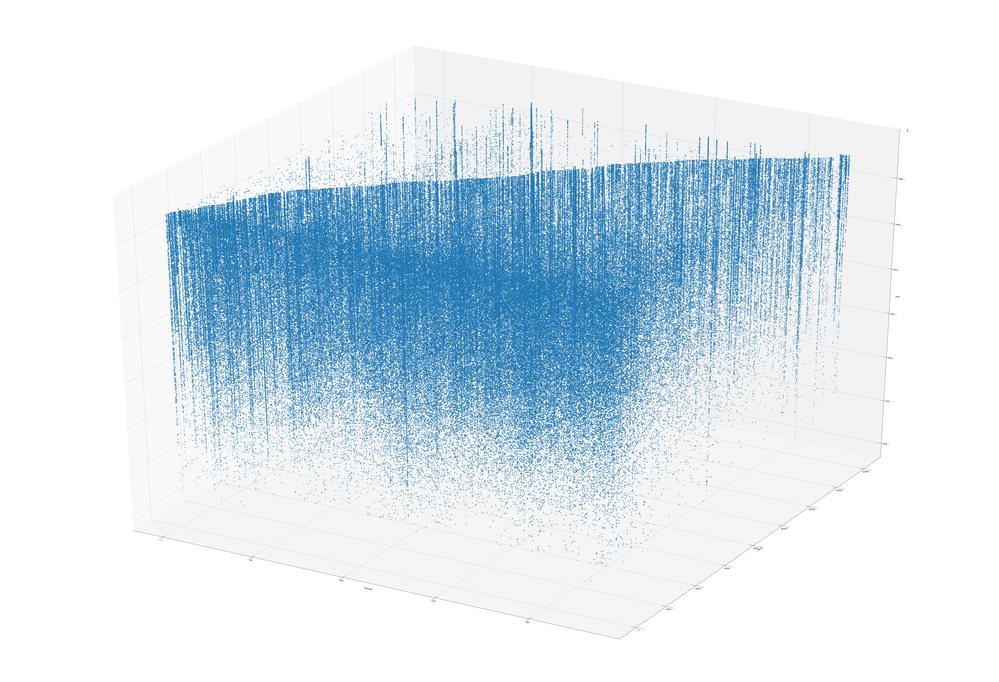

In [ ]:
from mpl_toolkits import mplot3d
import numpy as np
import matplotlib.pyplot as plt
import datetime

fig = plt.figure(figsize = (100, 70))
ax = plt.axes(projection ="3d")
datacluster = pd.read_csv ('datacluster_seconds.csv')
datacluster
ax.scatter3D(datacluster[' ProductID'], datacluster[' UserID'], datacluster['# Date'])
#x = [datetime.datetime.strptime(d,"%Y-%m-%d").date() for d in r['date']]
#x1 = matplotlib.dates.date2num(x)

#ax.scatter3D(x, r['productid'], r['userid'], color = "green")
#ax.scatter(r['productid'], r['userid'])

In [ ]:
NYC_meta[NYC_meta['label'] == '-1'].shape[0]/NYC_meta.shape[0]

0.10272885264529928